In [2]:
pip install geopandas

     |████████████████████████████████| 1.0MB 4.4MB/s 
     |████████████████████████████████| 14.8MB 322kB/s 
     |████████████████████████████████| 6.5MB 41.4MB/s 


In [11]:
# การนำเข้าไลบรารีที่ต้องใช้งาน
import pandas as pd
import numpy as np
import math

import geopandas as gpd
import json
import bokeh.io
bokeh.io.output_notebook()
from bokeh.io import output_notebook, show, output_file
from bokeh.plotting import figure
from bokeh.models import GeoJSONDataSource, LinearColorMapper, ColorBar, NumeralTickFormatter
from bokeh.palettes import brewer, d3

from bokeh.io.doc import curdoc
from bokeh.models import Slider, HoverTool, Select
from bokeh.layouts import widgetbox, row, column

In [12]:
#การอนุญาตให้เข้าถึงข้อมูลใน Google Drive
from google.colab import drive 
drive.mount('/content/gdrive')

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).


In [13]:
data_df_thai = pd.read_excel('gdrive/My Drive/CovidMap/data_excel2.xlsx')
data_df_thai.rename(columns={'Cases':'Cases','Province':'NAME_1'},inplace=True)
data_df_thai.drop(columns={'Male','Female','UnknownGen','ThaiNation','ForeignNat','Deaths'},inplace=True)
data_df_thai.head()

,Lat,Long,NAME_1,UnknownNat,Cases
0,15.8926,104.741,Amnat Charoen,0,4
1,14.6235,100.349,Ang Thong,0,25
2,13.7718,100.624,Bangkok Metropolis,12,2431
3,18.1488,103.711,Bueng Kan,0,0
4,14.8200,102.957,Buriram,0,14


In [14]:
fp = 'gdrive/My Drive/CovidMap/THA_adm1.shp'
sf_thai = gpd.read_file(fp)
sf_thai.head()

,ID_0,ISO,NAME_0,ID_1,NAME_1,TYPE_1,ENGTYPE_1,NL_NAME_1,VARNAME_1,geometry
0,228,THA,Thailand,1,Amnat Charoen,Changwat,Province,จังหวัดอำนาจเจริ,None,"POLYGON ((104.97262 16.27536, 104.97290 16.275..."
1,228,THA,Thailand,2,Ang Thong,Changwat,Province,จังหวัดอ่างทอง,None,"POLYGON ((100.34077 14.78768, 100.34173 14.785..."
2,228,THA,Thailand,3,Bangkok Metropolis,Changwat,Province,จังหวัดเชียงใหม่,Bangkok|Krung Thep|Krung Thep Maha Nakhon|Phra...,"POLYGON ((100.62670 13.94395, 100.62648 13.941..."
3,228,THA,Thailand,4,Bueng Kan,Changwat,Province,บึงกาฬ,None,"POLYGON ((103.41059 18.44627, 103.41159 18.446..."
4,228,THA,Thailand,5,Buri Ram,Changwat,Province,จังหวัดบุรีรัมย์,Buri Rum,"POLYGON ((102.93896 15.78453, 102.93933 15.784..."


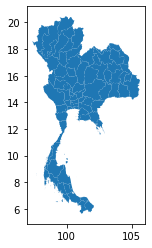

In [15]:
sf_thai.plot()

In [16]:
sf_thai.to_crs("EPSG:4326") 
sf_thai.area/10**6


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: UserWarning: Geometry is in a geographic CRS. Results from 'area' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  This is separate from the ipykernel package so we can avoid doing imports until


0     2.736178e-07
1     7.975912e-08
2     1.307707e-07
3     3.412817e-07
4     8.457145e-07
          ...     
72    9.405204e-07
73    5.606341e-07
74    6.646345e-07
75    3.621380e-07
76    3.455571e-07
Length: 77, dtype: float64

In [17]:
merged = sf_thai.merge(data_df_thai, on = 'NAME_1', how = 'left')
merged.head()

,ID_0,ISO,NAME_0,ID_1,NAME_1,TYPE_1,ENGTYPE_1,NL_NAME_1,VARNAME_1,geometry,Lat,Long,UnknownNat,Cases
0,228,THA,Thailand,1,Amnat Charoen,Changwat,Province,จังหวัดอำนาจเจริ,None,"POLYGON ((104.97262 16.27536, 104.97290 16.275...",15.8926,104.741,0.0,4.0
1,228,THA,Thailand,2,Ang Thong,Changwat,Province,จังหวัดอ่างทอง,None,"POLYGON ((100.34077 14.78768, 100.34173 14.785...",14.6235,100.349,0.0,25.0
2,228,THA,Thailand,3,Bangkok Metropolis,Changwat,Province,จังหวัดเชียงใหม่,Bangkok|Krung Thep|Krung Thep Maha Nakhon|Phra...,"POLYGON ((100.62670 13.94395, 100.62648 13.941...",13.7718,100.624,12.0,2431.0
3,228,THA,Thailand,4,Bueng Kan,Changwat,Province,บึงกาฬ,None,"POLYGON ((103.41059 18.44627, 103.41159 18.446...",18.1488,103.711,0.0,0.0
4,228,THA,Thailand,5,Buri Ram,Changwat,Province,จังหวัดบุรีรัมย์,Buri Rum,"POLYGON ((102.93896 15.78453, 102.93933 15.784...",NaN,NaN,NaN,NaN


In [21]:
#Read data to json
merged_json = json.loads(merged.to_json())

#Convert to str like object
json_data = json.dumps(merged_json)
geosource = GeoJSONDataSource(geojson = json_data)


#Define a sequential multi-hue color palette.
#palette = brewer['YlGnBu'][8]
palette = brewer['RdYlGn'][8]
#Reverse color order so that dark blue is highest obesity.
#palette = palette[::-1]
#Instantiate LinearColorMapper that linearly maps numbers in a range, into a sequence of colors. Input nan_color.
color_mapper = LinearColorMapper(palette = palette, low = merged['Cases'].min(), high = merged['Cases'].max(), nan_color = '#d9d9d9')
#Define custom tick labels for color bar.
tick_labels = {'1000': '>1000'}

#Add hover tool
hover = HoverTool(tooltips = [ ('จังหวัด','@NAME_1'),('จำนวนผู้ป่วย','@Cases')])
#Create color bar. 
color_bar = ColorBar(color_mapper=color_mapper, label_standoff=8,width = 500, height = 20,
                     border_line_color=None,location = (0,0), orientation = 'horizontal', major_label_overrides = tick_labels)
#Create figure object.
p = figure(title = 'แผนที่แสดงจำนวนผู้ป่วยโควิด 19', plot_height = 800 , plot_width = 600, toolbar_location = None, tools = [hover])

p.title.align = 'center'
p.title.text_font_size = '20pt'
p.title.text_font = 'serif'

p.xaxis.visible = False
p.yaxis.visible = False
p.xgrid.grid_line_color = None
p.ygrid.grid_line_color = None
#Add patch renderer to figure. 
p.patches('xs','ys', source = geosource,fill_color = {'field' :'Cases', 'transform' : color_mapper},
          line_color = 'black', line_width = 0.25, fill_alpha = 0.8)
#Specify layout
p.add_layout(color_bar, 'below')

show(p)